In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os, scipy
import matplotlib.colors as mcolors
import networkx as nx
import pickle
import copy
from numba.typed import Dict
from numba.core import types

# We import the model, stimuli, and the optimal control package
from neurolib.models.wc import WCModel
from neurolib.utils.stimulus import ZeroInput
from neurolib.control.optimal_control import oc_wc
from neurolib.control.optimal_control import cost_functions

import matplotlib as mpl
label_size= 24
mpl.rcParams['xtick.labelsize'] = label_size
mpl.rcParams['ytick.labelsize'] = label_size
mpl.rcParams['font.size'] = label_size
mpl.rcParams['axes.titlesize'] = label_size

# This will reload all imports as soon as the code changes
%load_ext autoreload
%autoreload 2

while "Promotion/neurolib" in os.getcwd():
    os.chdir('..')

pickledir = os.path.join(os.getcwd(), "neurolib_aln_osc_datastorage/optimal_control/WP2/2n")
dir = os.path.join(pickledir, "beat_osc")

print(dir)

def plotspectrum(data, fmax=1., filename=None, vlines=None):

    ps_comp = None

    for d in data:
        ps = np.abs(np.fft.fft(d))
        ps_plot = ps[:int(len(ps)/2)] / (len(ps)/2)
        ps_plot[0] = 0.
        fr = np.linspace(0,1./(2.*dt),len(ps_plot))

        if ps_comp is None:
            ps_comp = ps_plot
        else:
            ps_comp += ps_plot

        plt.plot(fr, ps_plot)

    if vlines is not None:
        plt.vlines(vlines, 0, 1, color="gray", linestyle=":")

    plt.xlim(0,fmax)
    plt.ylim(0,1.3*np.amax(ps_plot))
    #plt.ylim(0,0.5)
    plt.tight_layout()

    if filename is not None:
        plt.savefig(os.path.join(dir, filename))
    
    plt.show()

    maxfreqind = np.where(ps_comp == max(ps_comp[1:]))
    print("freq of max = ", fr[maxfreqind])
    print("period of max = ", 1./fr[maxfreqind])

    return (1./fr[maxfreqind])[0]

/home/lena/Promotion/neurolib_aln_osc_datastorage/optimal_control/WP2/2n/beat_osc


In [23]:
N = 2

cmats = [np.zeros((N,N))]
cmats[0] = np.array( [[0,1], [1,0]] )
dmat = np.zeros((N,N))
dmat[0,1] = 1

coupling_array = np.array( [0.2, 0.4, 0.6] )
delay_array = np.array( [3,6,12] )

eext = np.arange(0.8, 2.8, 0.2)
iext = np.arange(0., 1.5, 0.2)

#eext = [2.0]
#iext = [1.0]

----------------------------------------------------------- 0 0 0
----------------------------------------------------------- 0 0 1
----------------------------------------------------------- 0 0 2
----------------------------------------------------------- 0 1 0
----------------------------------------------------------- 0 1 1
----------------------------------------------------------- 0 1 2
----------------------------------------------------------- 0 2 0
0.8 0.0


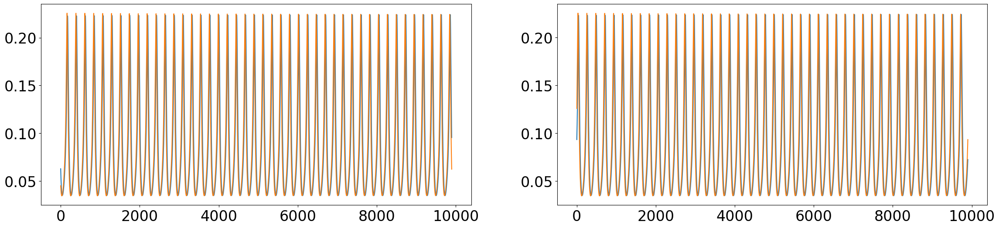

0.8 0.2


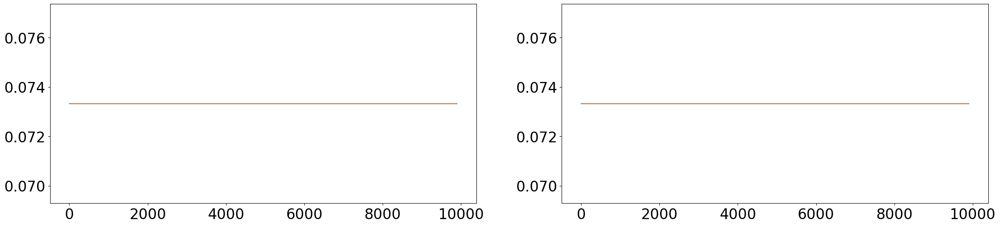

0.8 0.4


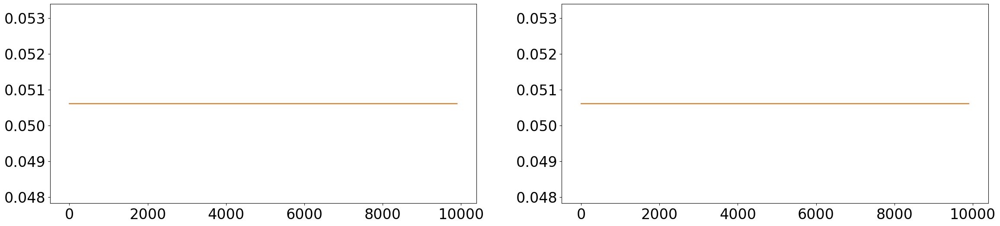

0.8 0.6000000000000001


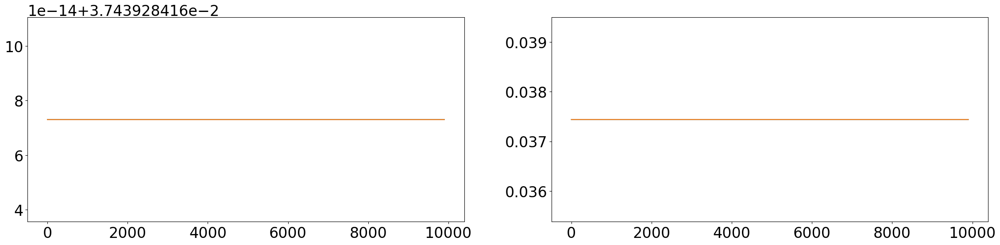

0.8 0.8


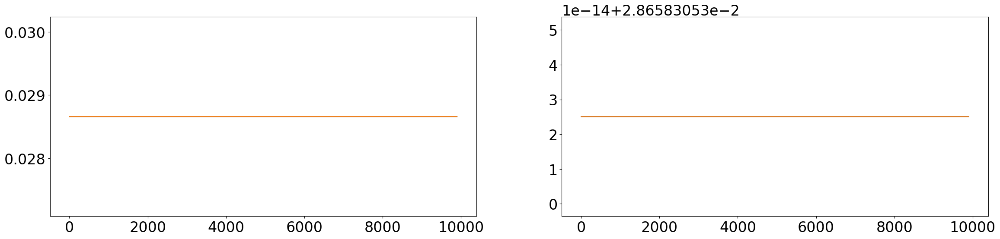

0.8 1.0


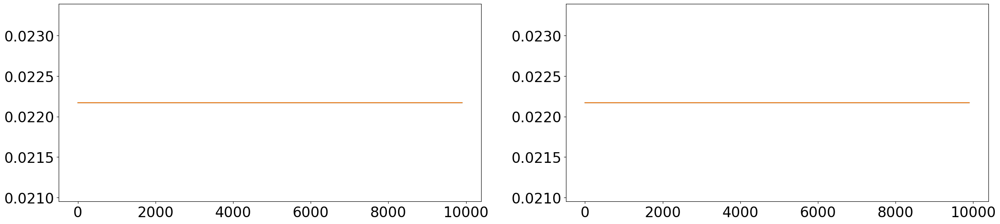

0.8 1.2000000000000002


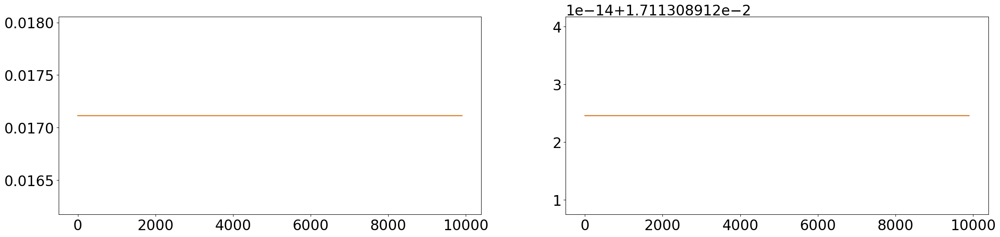

0.8 1.4000000000000001


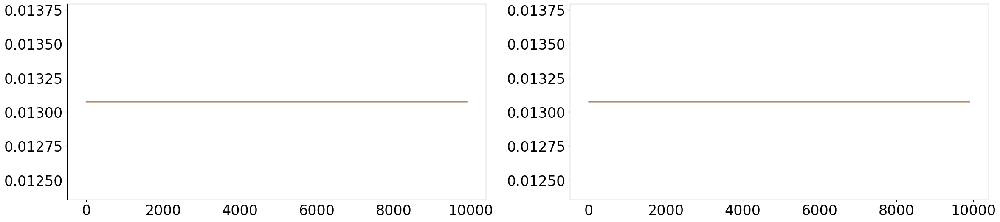

1.0 0.0


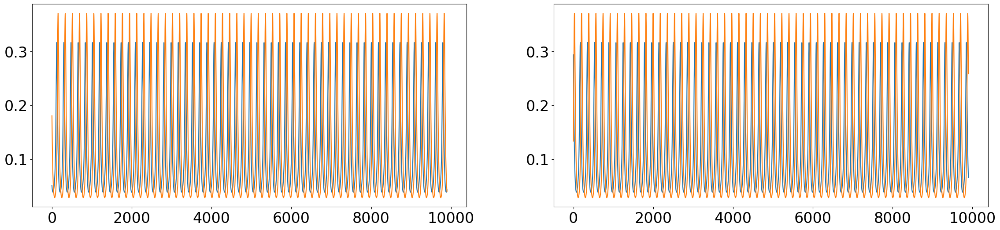

1.0 0.2


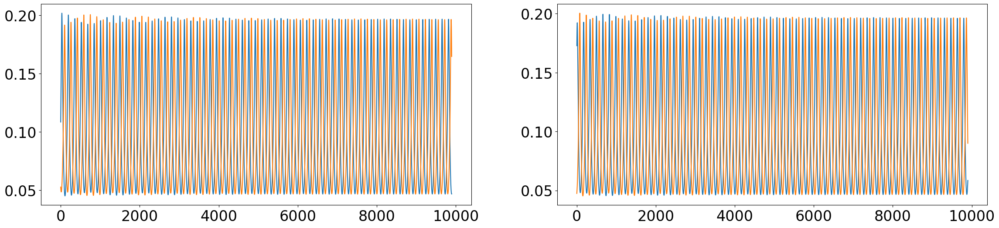

1.0 0.4


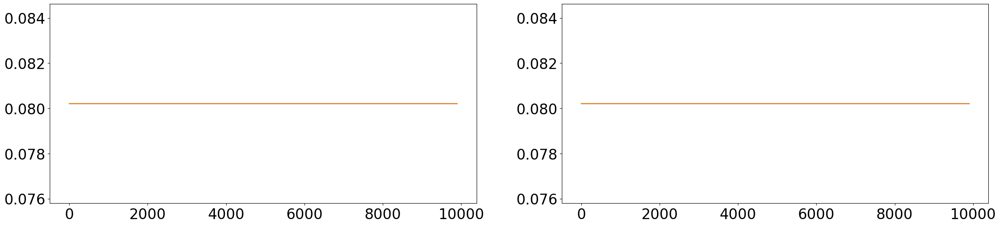

1.0 0.6000000000000001


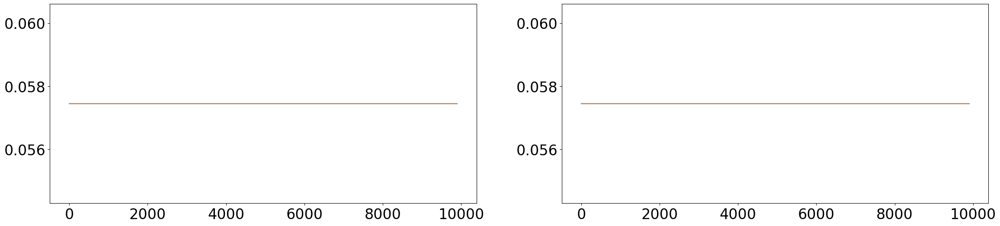

1.0 0.8


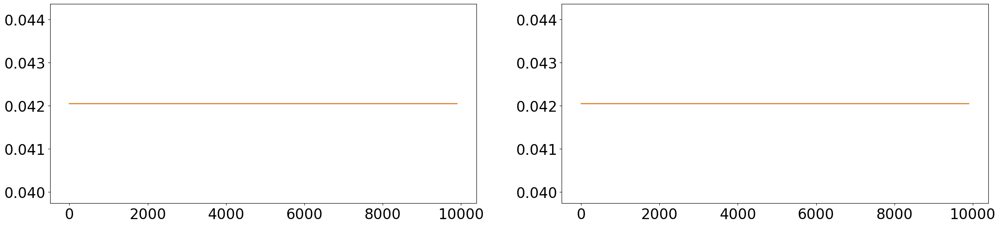

1.0 1.0


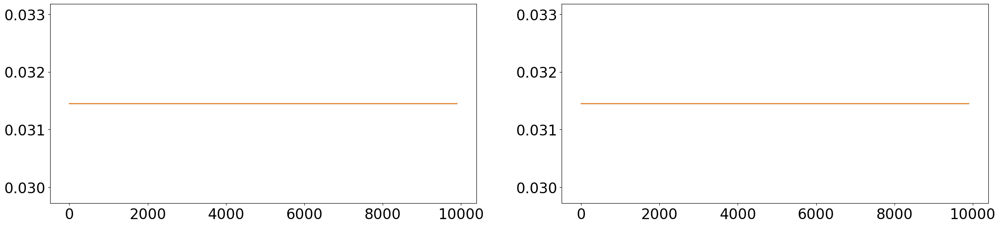

1.0 1.2000000000000002


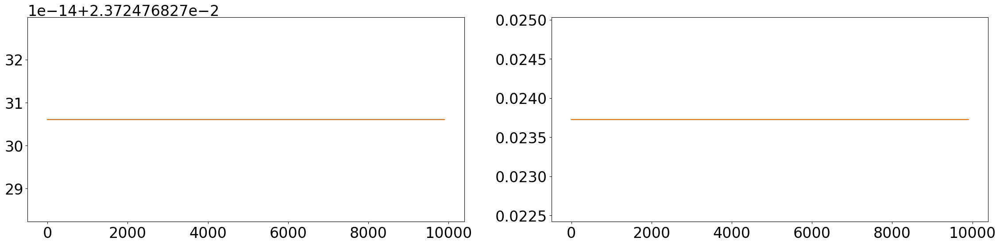

1.0 1.4000000000000001


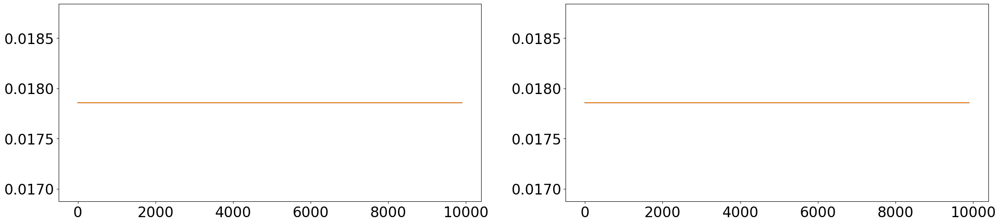

1.2 0.0


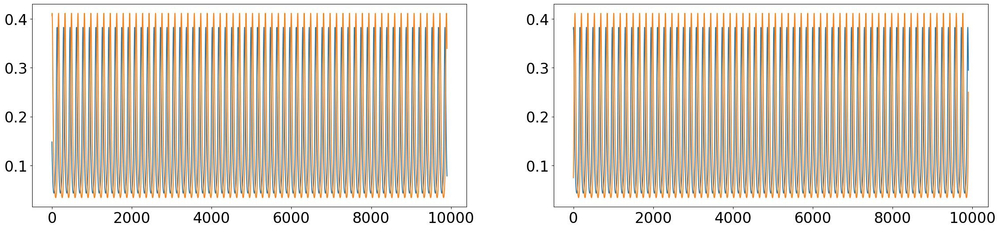

1.2 0.2


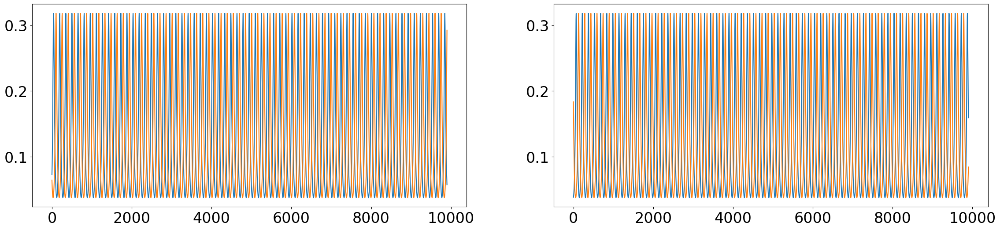

1.2 0.4


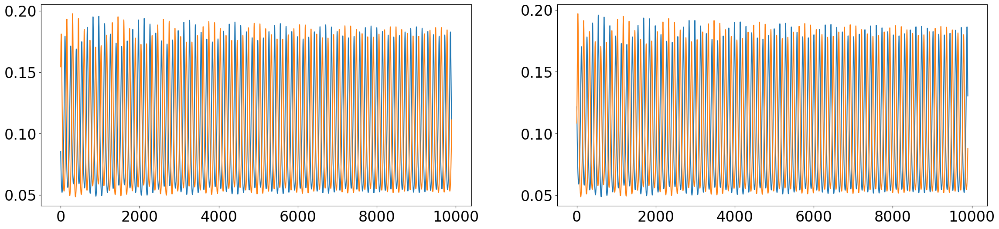

1.2 0.6000000000000001


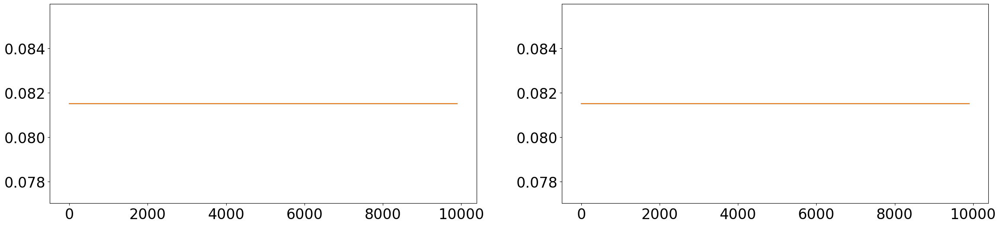

1.2 0.8


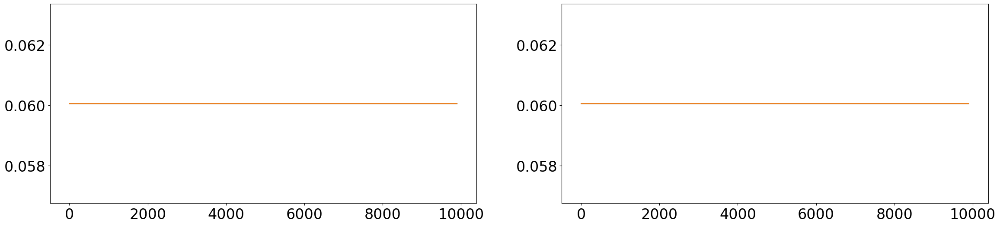

1.2 1.0


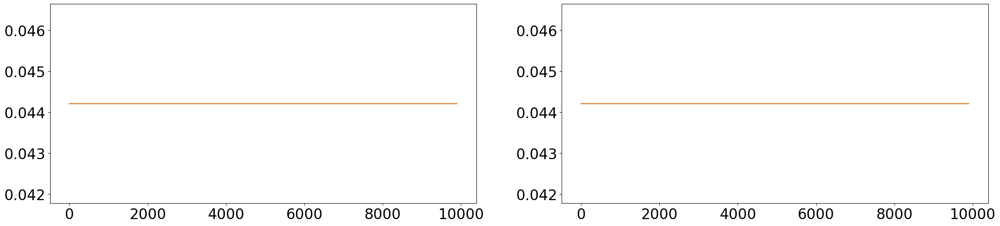

1.2 1.2000000000000002


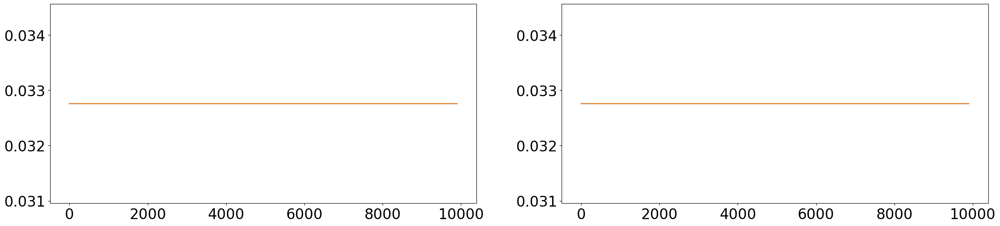

1.2 1.4000000000000001


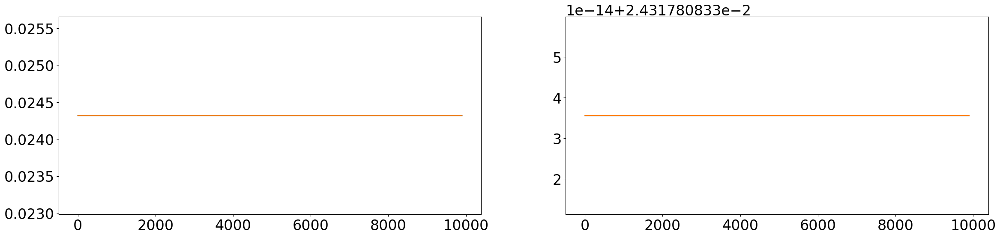

1.4 0.0


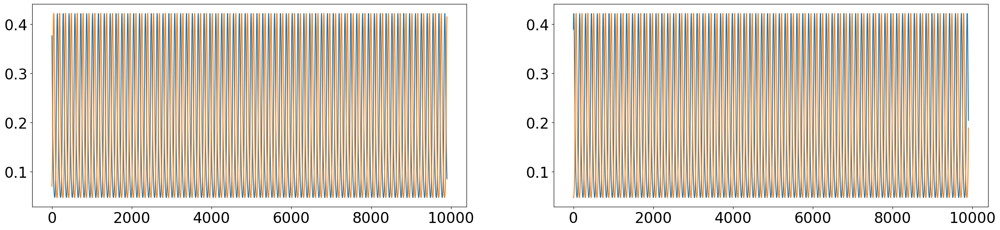

1.4 0.2


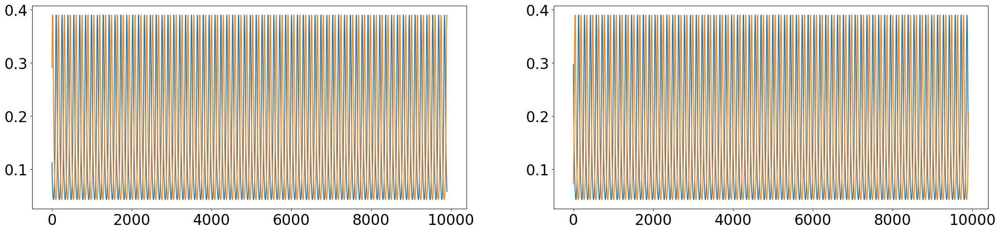

1.4 0.4


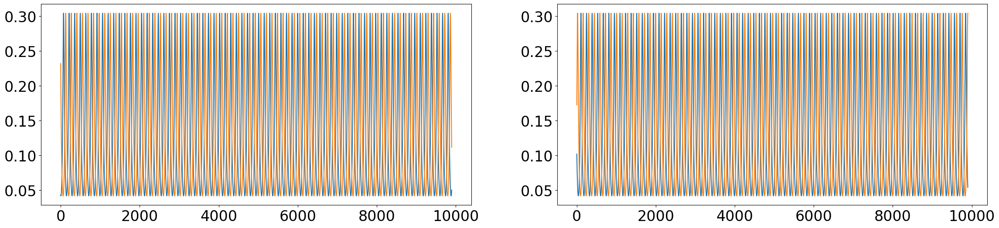

1.4 0.6000000000000001


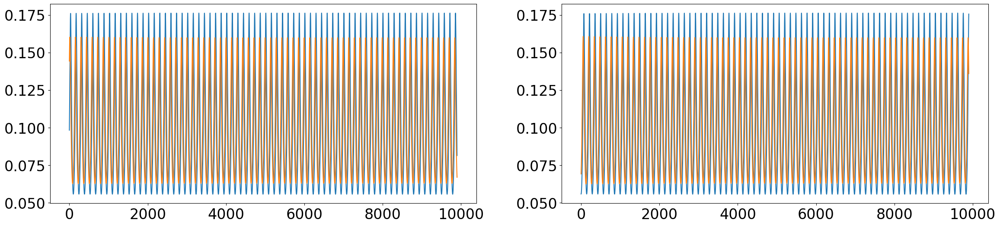

1.4 0.8


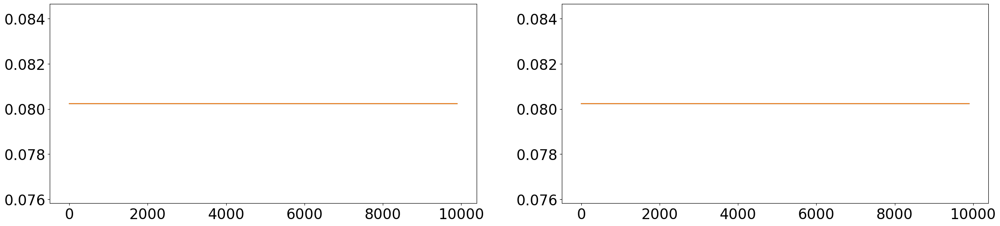

1.4 1.0


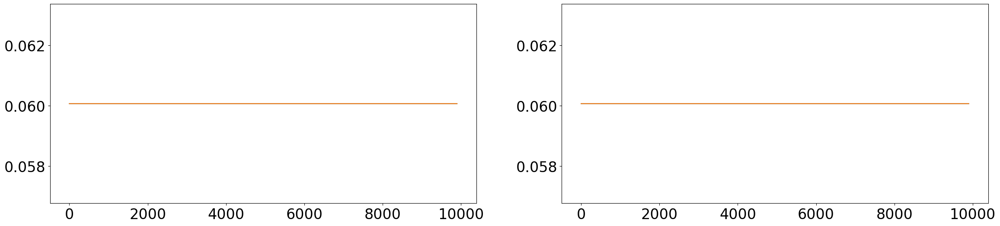

1.4 1.2000000000000002


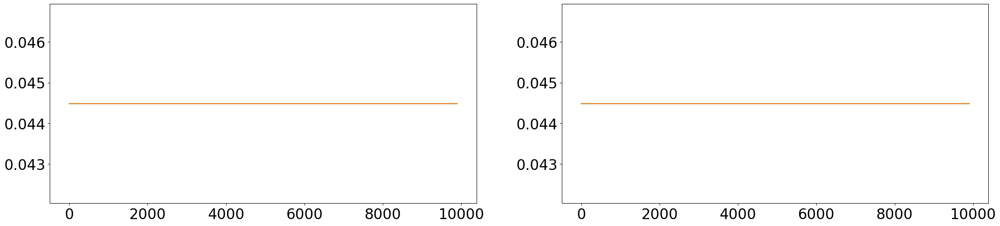

1.4 1.4000000000000001


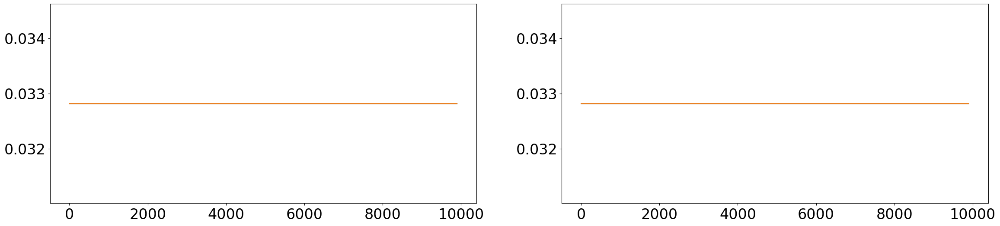

1.5999999999999999 0.0


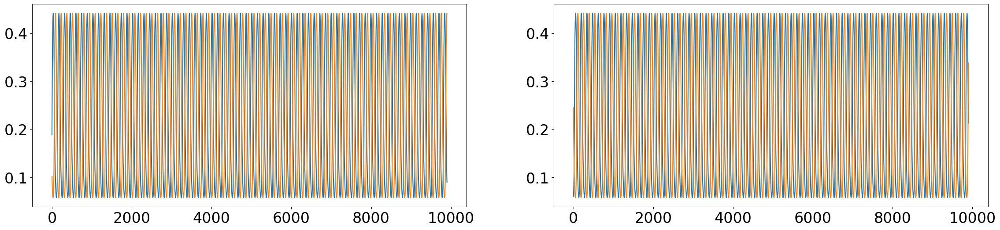

1.5999999999999999 0.2


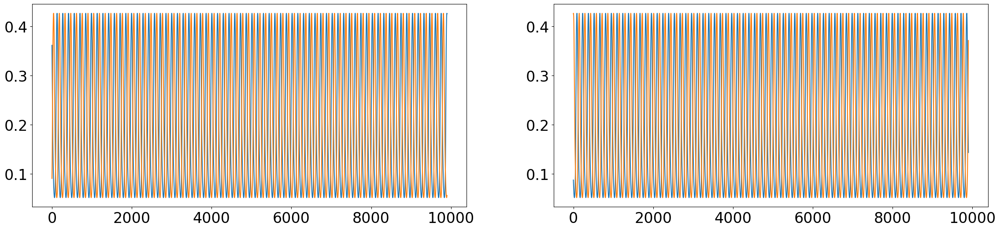

1.5999999999999999 0.4


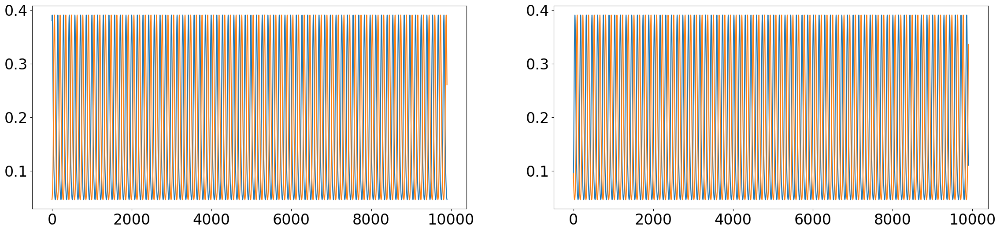

1.5999999999999999 0.6000000000000001


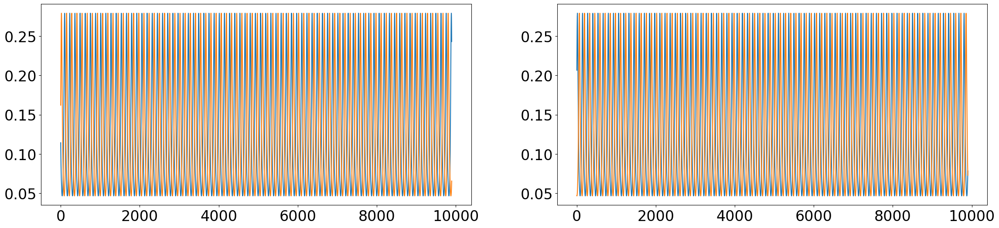

1.5999999999999999 0.8


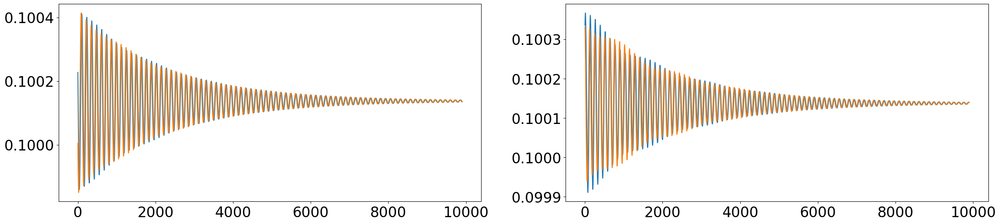

1.5999999999999999 1.0


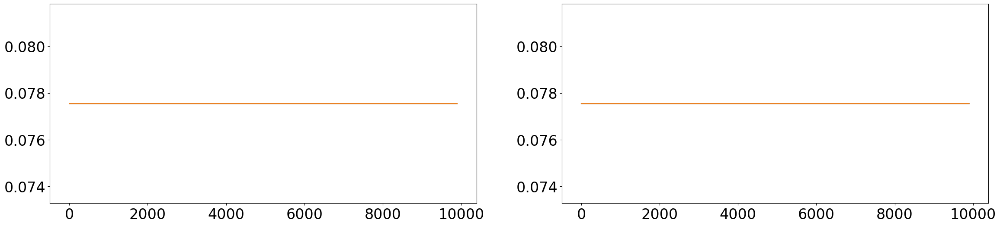

1.5999999999999999 1.2000000000000002


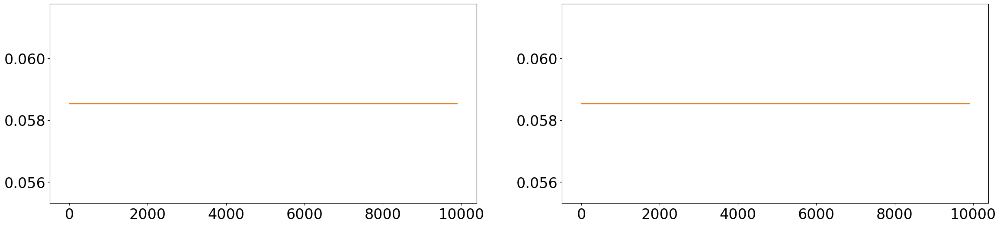

1.5999999999999999 1.4000000000000001


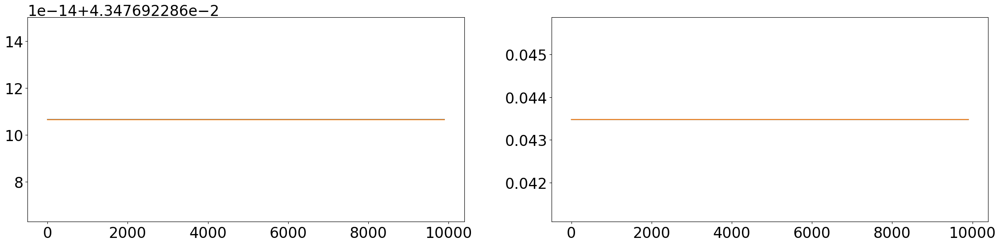

1.7999999999999998 0.0


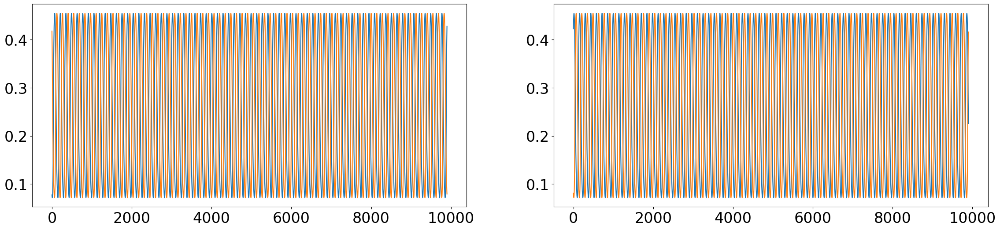

1.7999999999999998 0.2


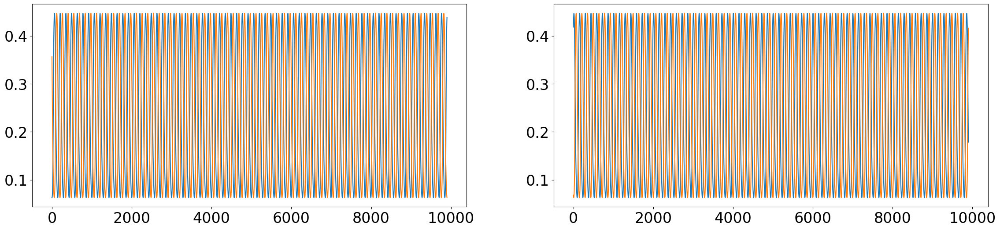

1.7999999999999998 0.4


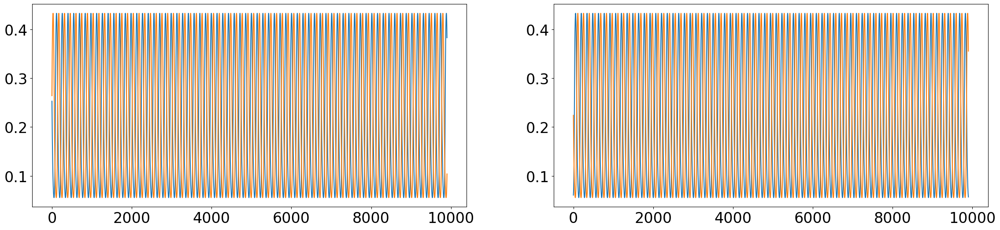

1.7999999999999998 0.6000000000000001


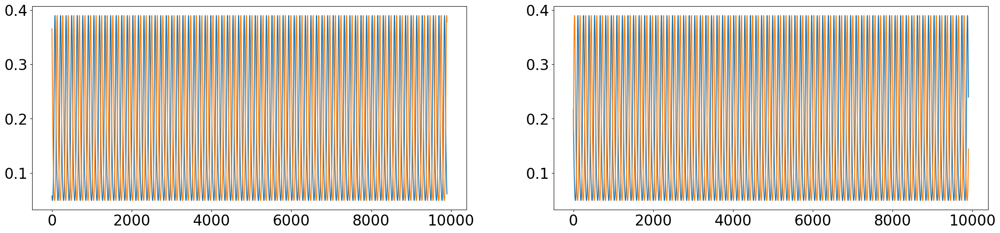

1.7999999999999998 0.8


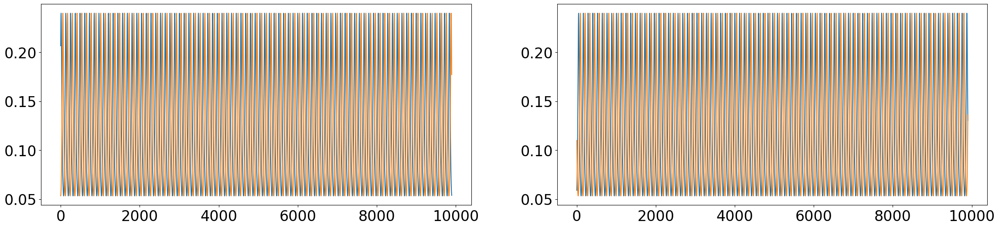

1.7999999999999998 1.0


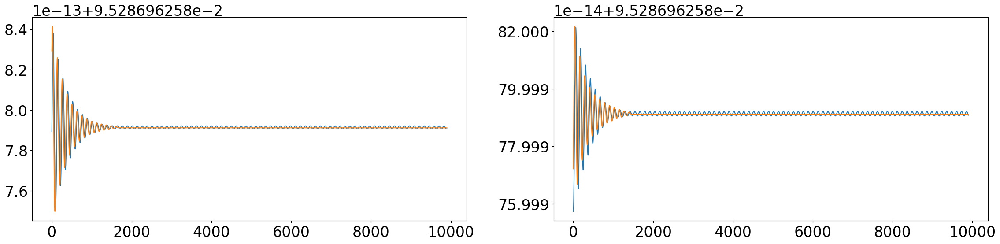

1.7999999999999998 1.2000000000000002


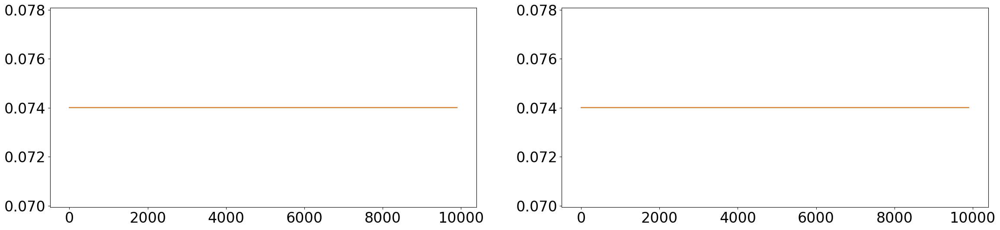

1.7999999999999998 1.4000000000000001


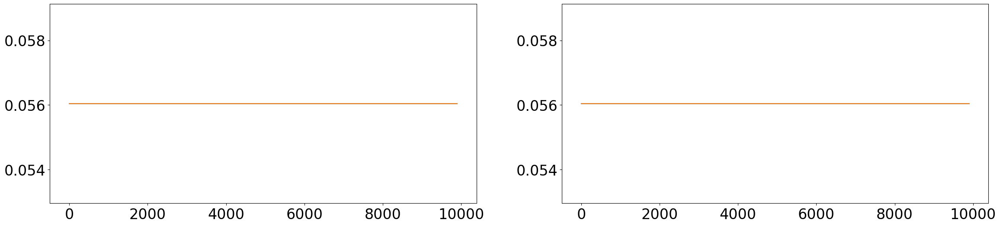

1.9999999999999998 0.0


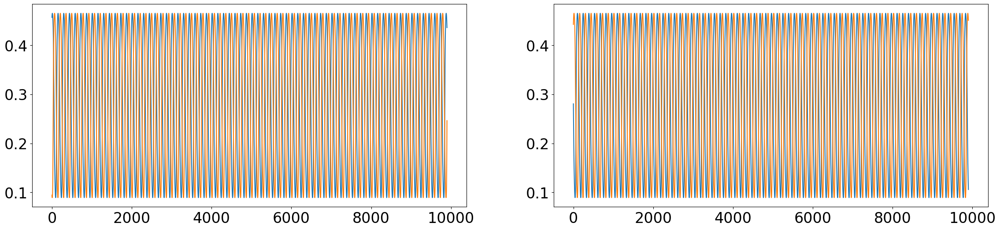

1.9999999999999998 0.2


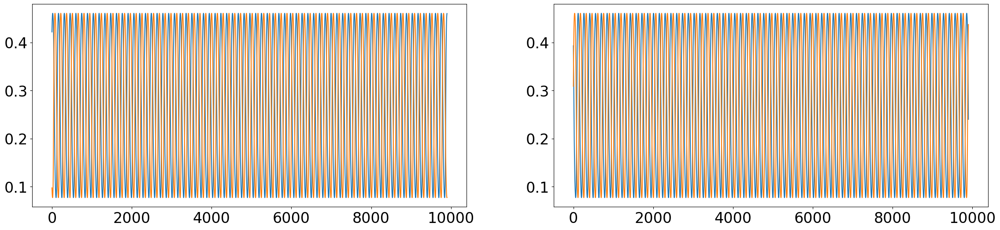

1.9999999999999998 0.4


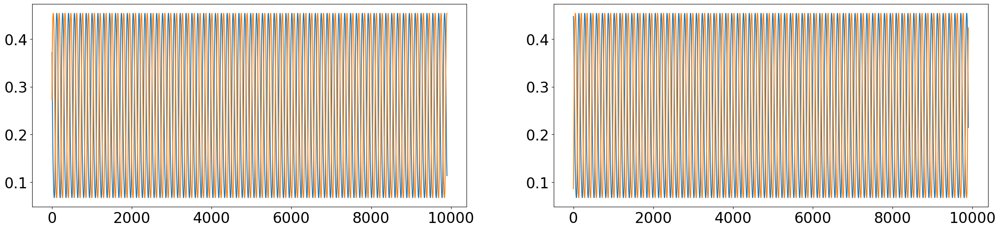

1.9999999999999998 0.6000000000000001


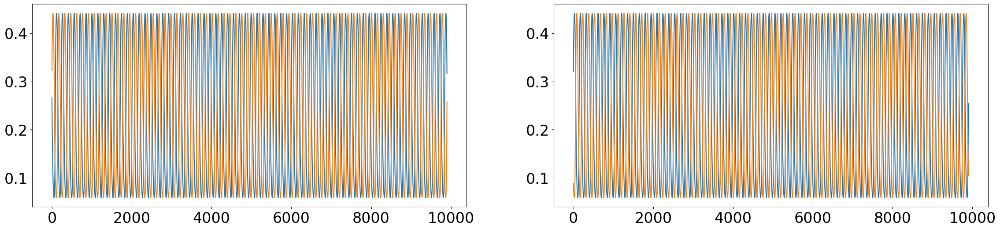

1.9999999999999998 0.8


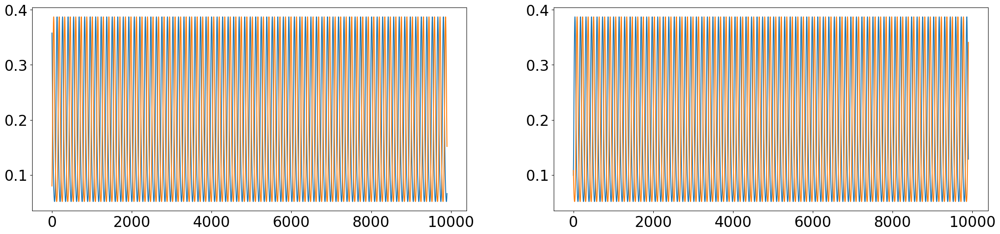

1.9999999999999998 1.0


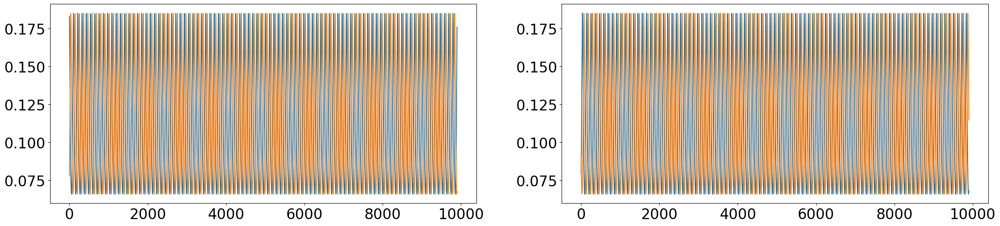

1.9999999999999998 1.2000000000000002


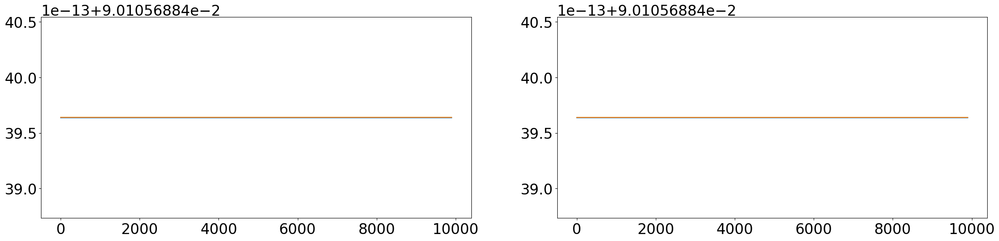

1.9999999999999998 1.4000000000000001


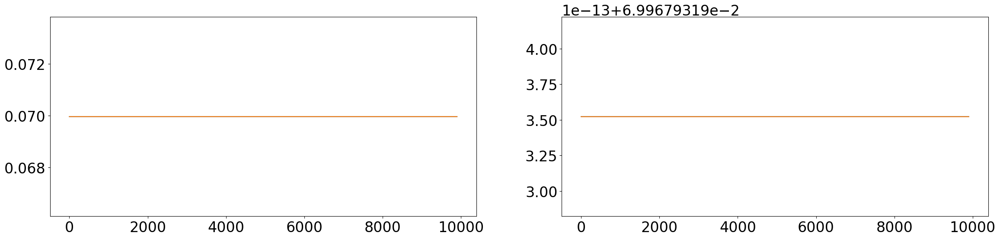

2.1999999999999997 0.0


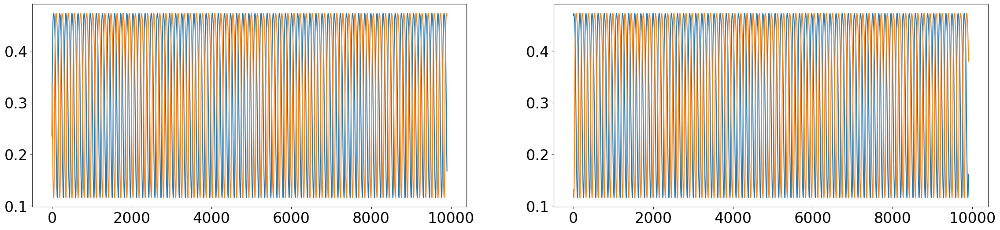

2.1999999999999997 0.2


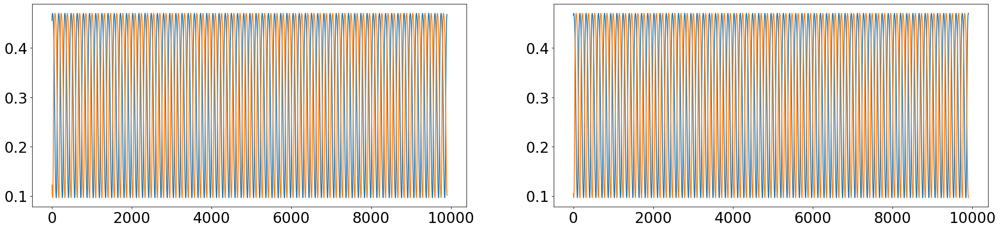

2.1999999999999997 0.4


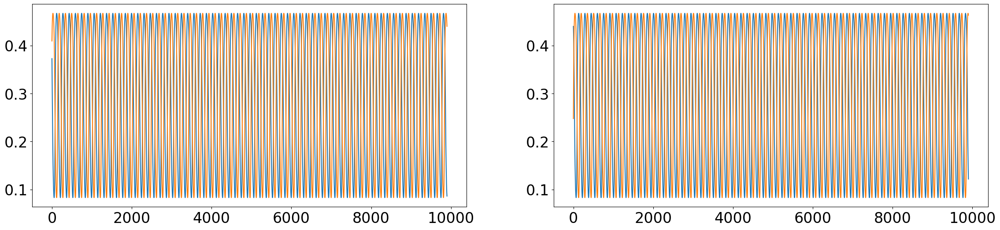

2.1999999999999997 0.6000000000000001


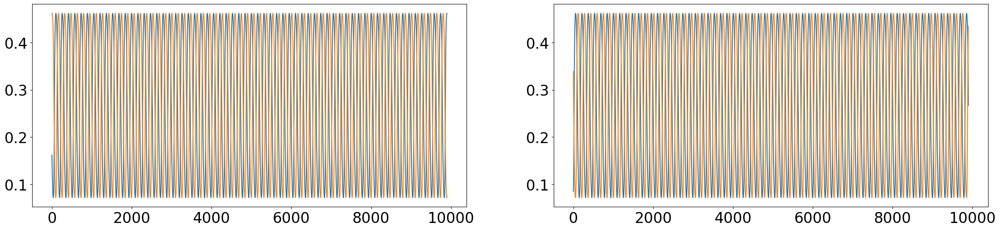

2.1999999999999997 0.8


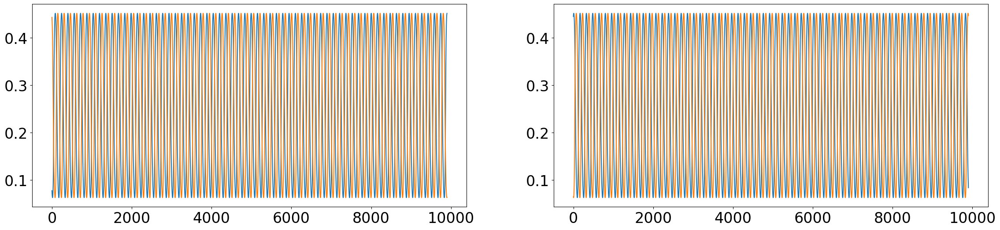

2.1999999999999997 1.0


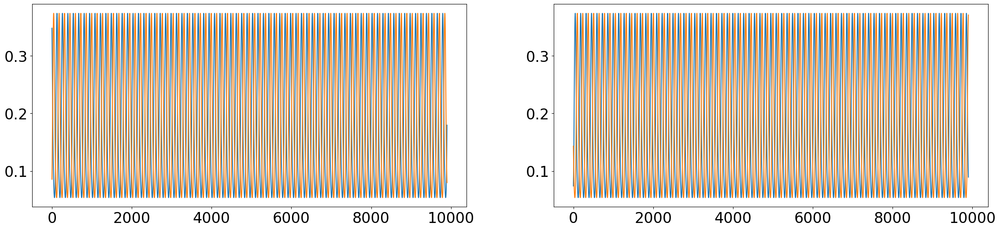

2.1999999999999997 1.2000000000000002


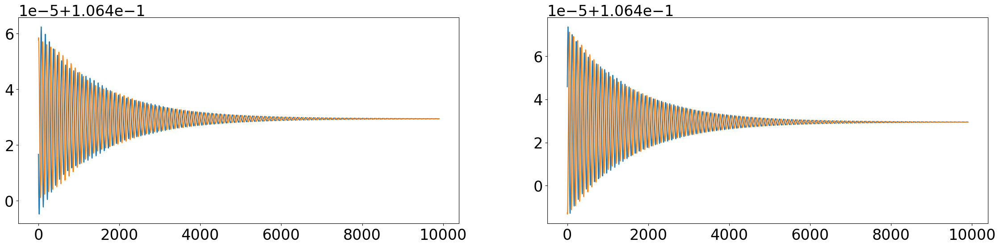

2.1999999999999997 1.4000000000000001


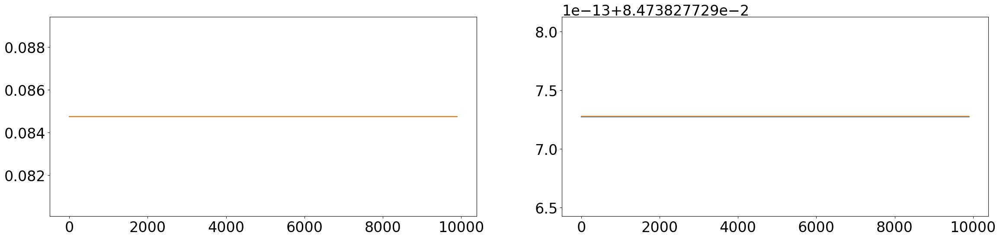

2.3999999999999995 0.0


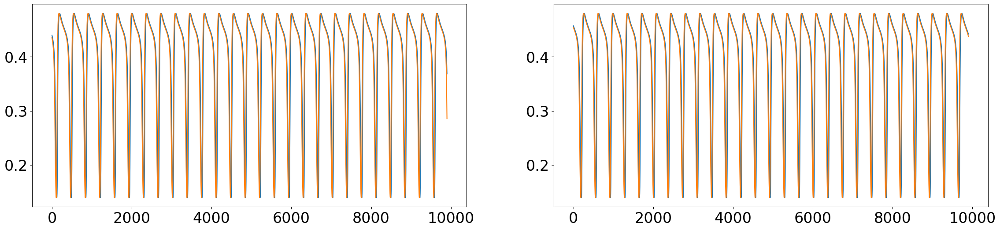

2.3999999999999995 0.2


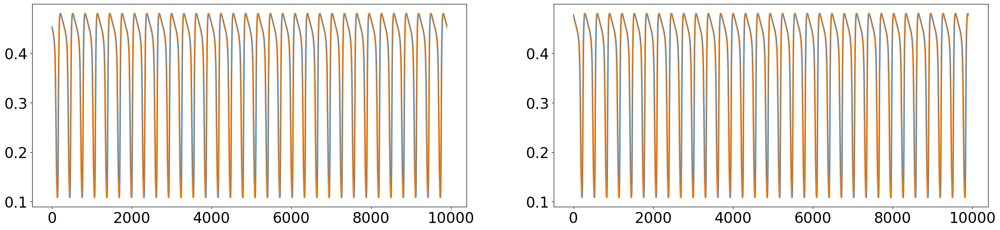

2.3999999999999995 0.4


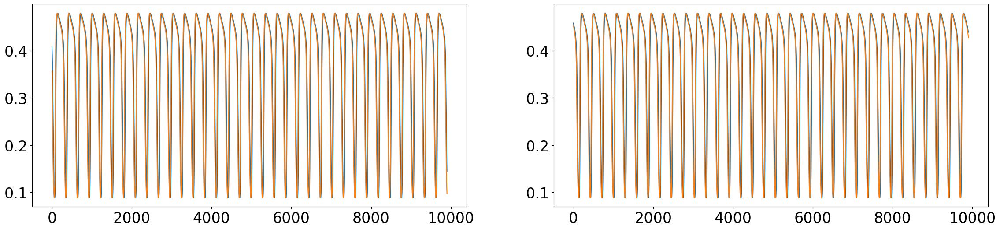

2.3999999999999995 0.6000000000000001


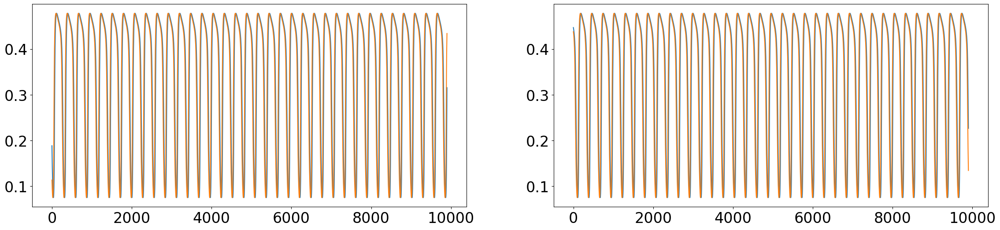

2.3999999999999995 0.8


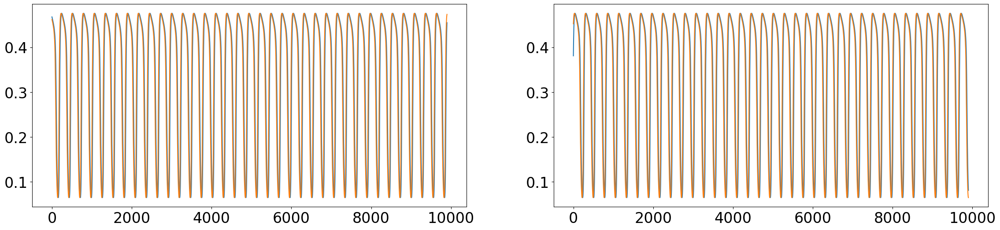

2.3999999999999995 1.0


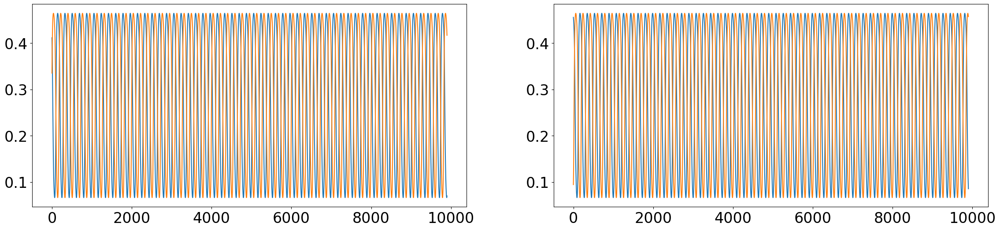

2.3999999999999995 1.2000000000000002


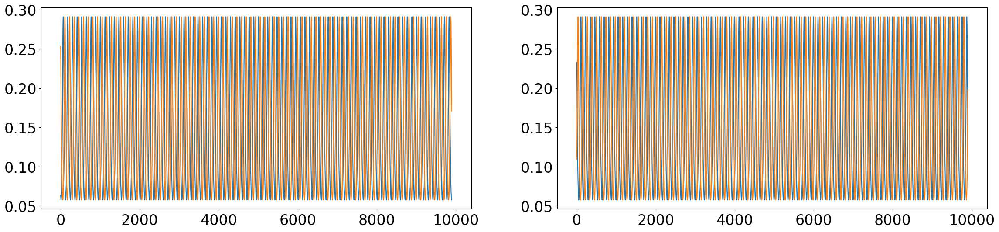

2.3999999999999995 1.4000000000000001


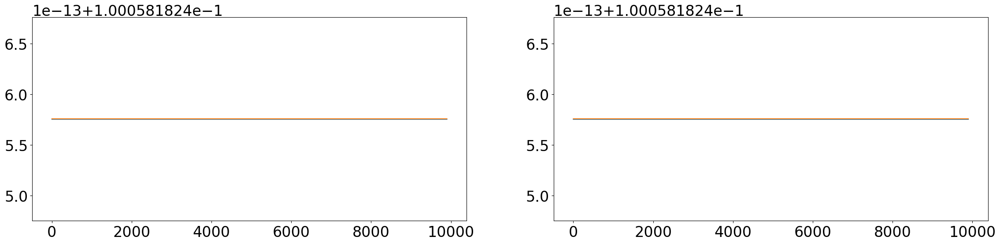

2.5999999999999996 0.0


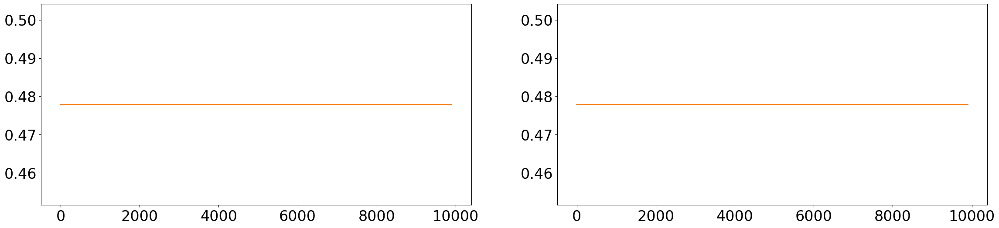

2.5999999999999996 0.2


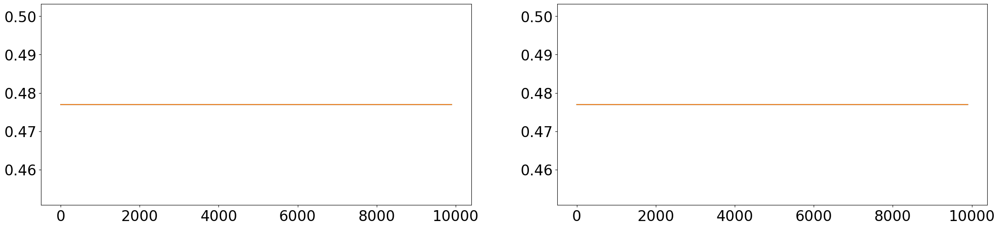

2.5999999999999996 0.4


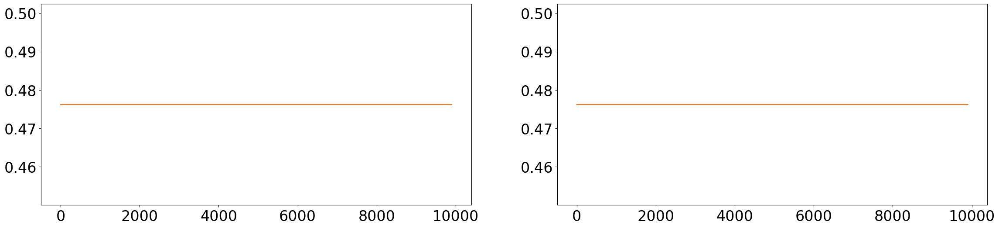

2.5999999999999996 0.6000000000000001


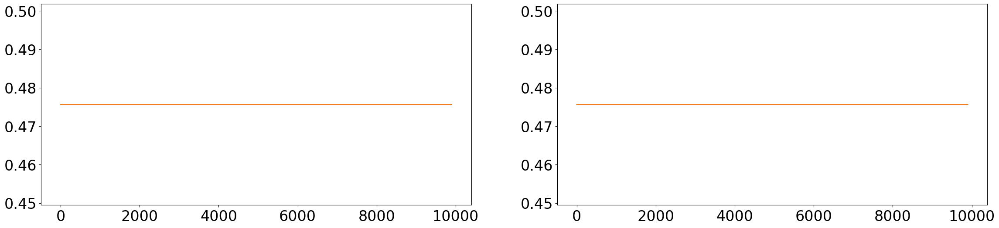

2.5999999999999996 0.8


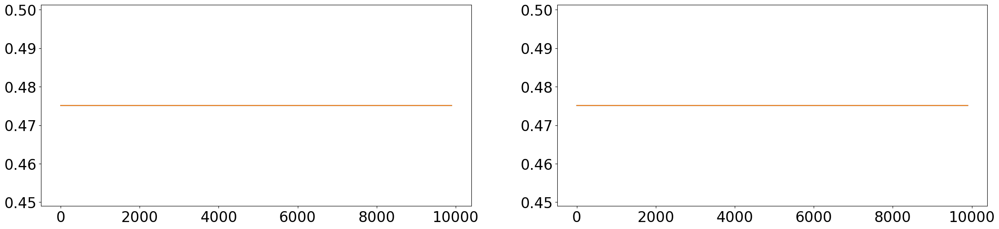

2.5999999999999996 1.0


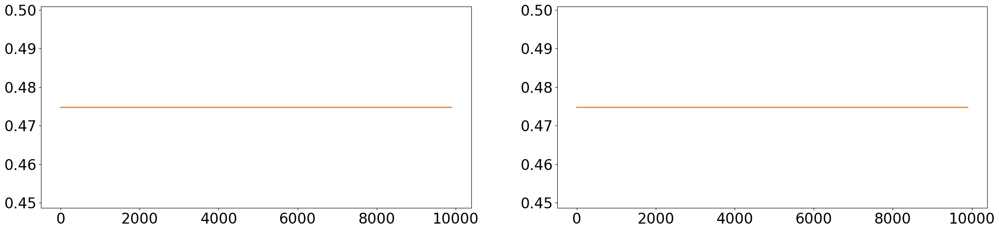

2.5999999999999996 1.2000000000000002


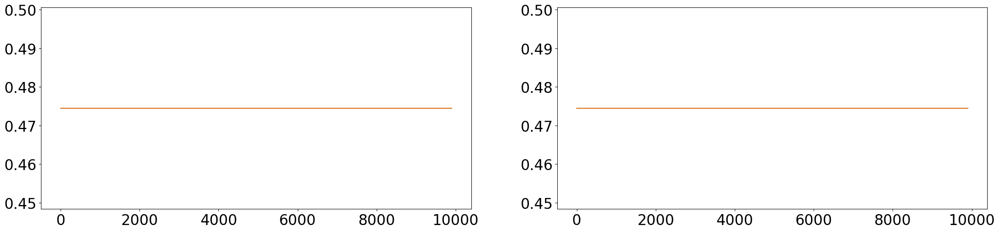

2.5999999999999996 1.4000000000000001


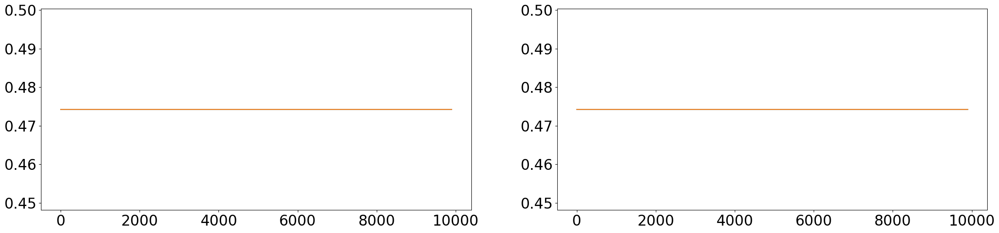

----------------------------------------------------------- 0 2 1
----------------------------------------------------------- 0 2 2


In [24]:
i = 0

for ci in range(len(coupling_array)):

    for di in range(len(delay_array)):

        print("-----------------------------------------------------------", i, ci, di)

        if ci not in [2]: continue
        if di not in [0]: continue 

        for e_ in eext:
            
            for i_ in iext:

                print(e_, i_)

                dmat_ = delay_array[di] * dmat * 20.
            
                model = WCModel(Cmat=cmats[i], Dmat=dmat_)
                model.params.K_gl = coupling_array[ci]
                dt = 0.1
                model.params.dt = dt

                dur = 4000.
                measure_dur = 30.
                i00, i01 = 0, 100
                i10, i11 = 20000, 20100

                model.params['duration'] = dur 
                test_input = ZeroInput().generate_input(duration=model.params['duration']+model.params.dt, dt=model.params.dt)
                test_input[:,i00:i01] = 6.
                test_input[:,i10:i11] = -6.
                model.params.exc_ext_baseline = e_
                model.params.inh_ext_baseline = i_
                model.params.exc_ext = test_input

                model.run()

                add_ind = 10000

                fig, ax = plt.subplots(1,2, figsize=(28,6))
                ax[0].plot(model.exc[0,i01+add_ind:i10])
                ax[0].plot(model.exc[1,i01+add_ind:i10])
                ax[1].plot(model.exc[0,i11+add_ind:])
                ax[1].plot(model.exc[1,i11+add_ind:])
                plt.show()

                if False:

                    fig, ax = plt.subplots(1,1, figsize=(28,6))
                    ax.plot(model.exc[0,-add_ind:])
                    ax.plot(model.exc[1,-add_ind:])
                    plt.show()

                    state = np.zeros((N,2, 10000))
                    state[0,0,:] = model.exc[0,-10000:]
                    state[1,0,:] = model.exc[1,-10000:]
                    state[0,1,:] = model.inh[0,-10000:]
                    state[1,1,:] = model.inh[1,-10000:]

                    target_period = plotspectrum( [model.exc[0,-10000:], model.exc[1,-10000:]], fmax = 0.3)

----------------------------------------------------------- 0 0 0
----------------------------------------------------------- 0 0 1
----------------------------------------------------------- 0 0 2
----------------------------------------------------------- 0 1 0
----------------------------------------------------------- 0 1 1
----------------------------------------------------------- 0 1 2
2.0 1.0


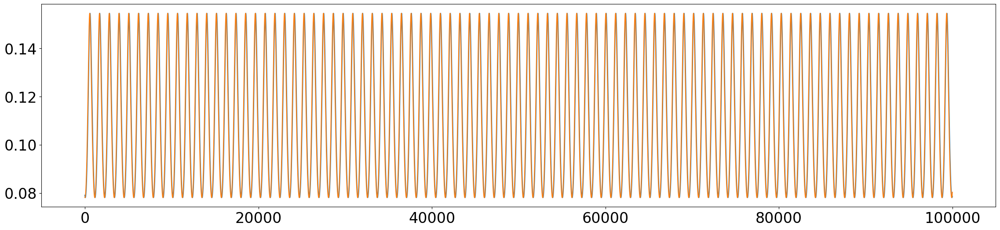

----------------------------------------------------------- 0 2 0
----------------------------------------------------------- 0 2 1
----------------------------------------------------------- 0 2 2


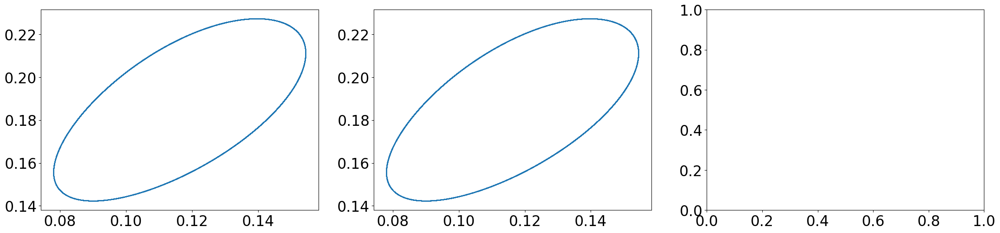

In [21]:
i = 0

for ci in range(len(coupling_array)):

    for di in range(len(delay_array)):

        print("-----------------------------------------------------------", i, ci, di)

        if ci not in [1]: continue
        if di not in [2]: continue 

        for e_ in eext:
            
            for i_ in iext:

                print(e_, i_)

                dmat_ = delay_array[di] * dmat * 20.
        
                model = WCModel(Cmat=cmats[i], Dmat=dmat_)
                model.params.K_gl = coupling_array[ci]
                dt = 0.01
                model.params.dt = dt

                dur = 10000.

                model.params['duration'] = dur 
                test_input = ZeroInput().generate_input(duration=model.params['duration']+model.params.dt, dt=model.params.dt)
                model.params.exc_ext_baseline = e_
                model.params.inh_ext_baseline = i_

                model.run()

                add_ind = int(1000/dt)

                fig, ax = plt.subplots(1,1, figsize=(28,6))
                ax.plot(model.exc[0,-add_ind:])
                ax.plot(model.exc[1,-add_ind:])
                plt.show()

                add_ind = int(3000/dt)


                fig, ax = plt.subplots(1,3, figsize=(28,6))
                ax[0].plot(model.exc[0,add_ind:], model.inh[0,add_ind:])
                ax[1].plot(model.exc[1,add_ind:], model.inh[1,add_ind:])


[   4  151  298  444  590  736  882 1029 1177 1325 1475 1626 1779 1932
 2087 2243 2400 2558 2717 2875 3033 3191 3348 3505 3662 3819 3975 4131
 4287 4442 4597 4752 4907 5062 5216 5370 5524 5678 5832 5985 6138 6291
 6443 6595 6747 6899 7050 7202 7353 7503 7654 7804 7954 8104 8254 8403
 8552 8701 8850 8998 9146 9294 9442 9589 9736 9884]
32 3191
109 736


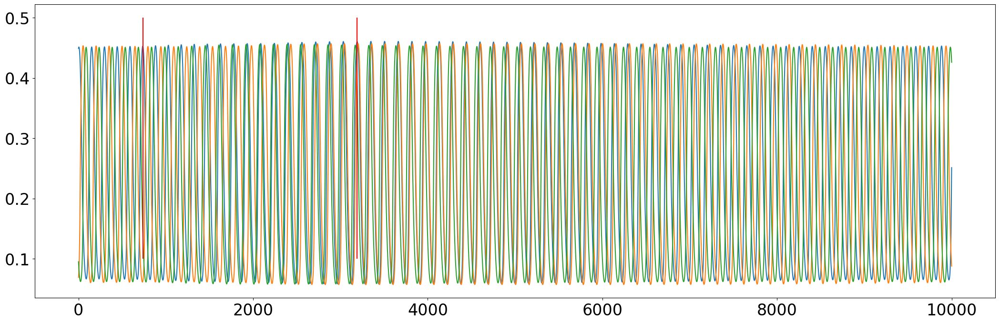

<function matplotlib.pyplot.show(close=None, block=None)>

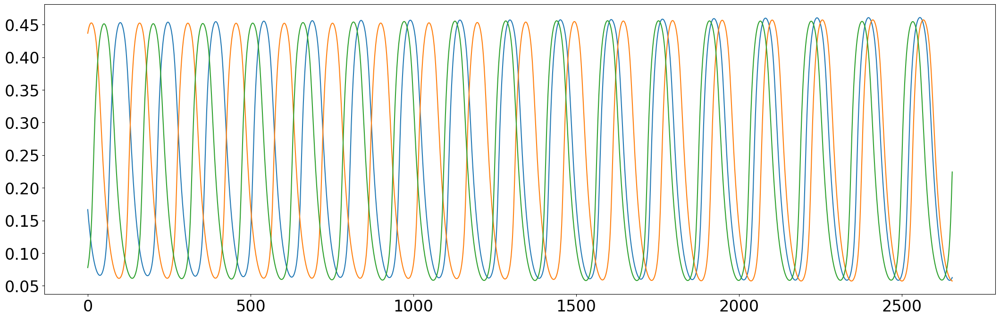

In [17]:
peaks = [scipy.signal.find_peaks(state[0,0,:])[0], scipy.signal.find_peaks(state[1,0,:])[0], scipy.signal.find_peaks(state[2,0,:])[0]]

mintotdiff = 10000
mintotdiffind = 0

maxtotdiff = 0
maxtotdiffind = 0

print(peaks[0])

for p in peaks[0][5:-5]:
    diff1 = np.abs(p - peaks[1])
    diff2 = np.abs(p - peaks[2])

    mindiff = min(diff1) + min(diff2)

    if mindiff < mintotdiff:
        mintotdiff = mindiff
        mintotdiffind = p

    if mindiff > maxtotdiff:
        maxtotdiff = mindiff
        maxtotdiffind = p



print(mintotdiff, mintotdiffind)
print(maxtotdiff, maxtotdiffind)

fix, ax = plt.subplots(1,1, figsize=(26,8))
ax.plot(state[0,0,:])
ax.plot(state[1,0,:])
ax.plot(state[2,0,:])
ax.vlines([maxtotdiffind, mintotdiffind], 0.1, 0.5, color="red")
plt.show()

fix, ax = plt.subplots(1,1, figsize=(26,8))
ax.plot(state[0,0,maxtotdiffind-100:mintotdiffind+100])
ax.plot(state[1,0,maxtotdiffind-100:mintotdiffind+100])
ax.plot(state[2,0,maxtotdiffind-100:mintotdiffind+100])
plt.show

In [26]:
data = dict()

data["control"] = [[None, None], [None, None], [None, None]]
data["state"] = [[None, None], [None, None], [None, None]]
data["init"] = [None, None]
data["weights"] = np.ones((3,2))
data["control_cost"] = np.zeros((3,2))
data["sync_cost"] = np.zeros((3,2))


einit = np.zeros((N, 1))
iinit = np.zeros((N, 1))

for n in range(N):
    einit[n,:] = state[n,0,mintotdiffind-500]
    iinit[n,:] = state[n,1,mintotdiffind-500]

data["init"][0] = [einit, iinit]

for n in range(N):
    einit[n,:] = state[n,0,maxtotdiffind-500]
    iinit[n,:] = state[n,1,maxtotdiffind-500]

data["init"][1] = [einit, iinit]

In [27]:
weights = Dict.empty(
        key_type=types.unicode_type,
        value_type=types.float64,
    )

weights["w_2"] = 1.0
weights["w_1"] = 0.0
weights["w_1T"] = 0.0
weights["w_1D"] = 0.0

def optimize_model(model, exprange):
    for l in range(2):
        for k in exprange:
            model.zero_step_encountered = False
            model.step = 10**(k)
            model.optimize(it)
        model.control_matrix = controlmat
    model.zero_step_encountered = False

    return

In [28]:
controlmat = np.zeros((N,2))
controlmat[:,0] = 1

costmat = np.zeros((N,2))
costmat[:,0] = 1

duration = 600
control_interval = [500, -1500]
cost_interval = [500, -1500]

maxstr = 5
pr = np.arange(0,501,10)

zero_input0 = ZeroInput().generate_input(duration=duration+model.params.dt, dt=model.params.dt)
zero_input = np.vstack( ([zero_input0]*2) )[np.newaxis,:,:]
zero_control = np.vstack( ([zero_input]*N))

---------------------------------------  F
---------------------------------------  CC
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -128.66649103008413
Cost in iteration 10: -128.66651610767335
Final cost : -128.66651610767335
Compute control for a deterministic system
Cost in iteration 0: -128.66651610767335
Cost in iteration 10: -128.66735703874585
Final cost : -128.66735703874585
Compute control for a deterministic system
Cost in iteration 0: -128.66735703874585
Cost in iteration 10: -128.67555287458063
Final cost : -128.67555287458063
Compute control for a deterministic system
Cost in iteration 0: -128.67555287458063
Cost in iteration 10: -128.68100226203984
Final cost : -128.68100226203984
Compute control for a deterministic system
Cost in iteration 0: -128.68100226203984
Cost in iteration 10: -128.68412572412126
Final cost : -128.68412572412126
Compute control for a deterministic system
Cost in iteration 0: -128.68

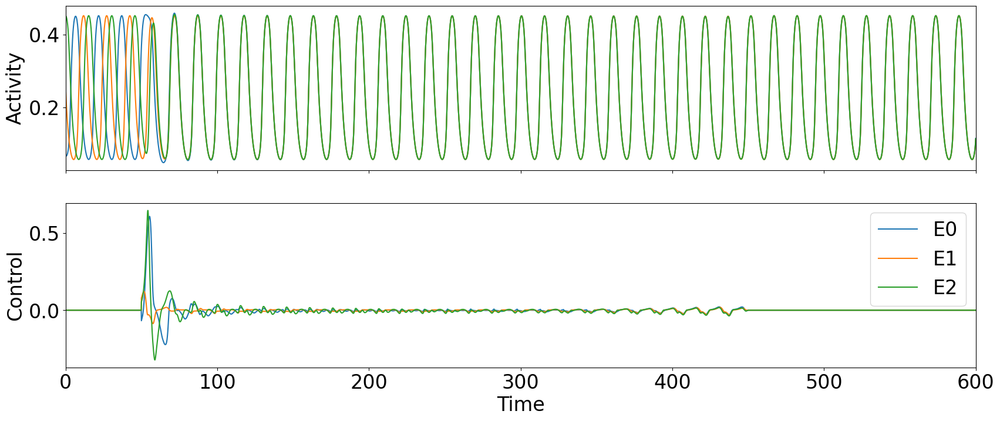

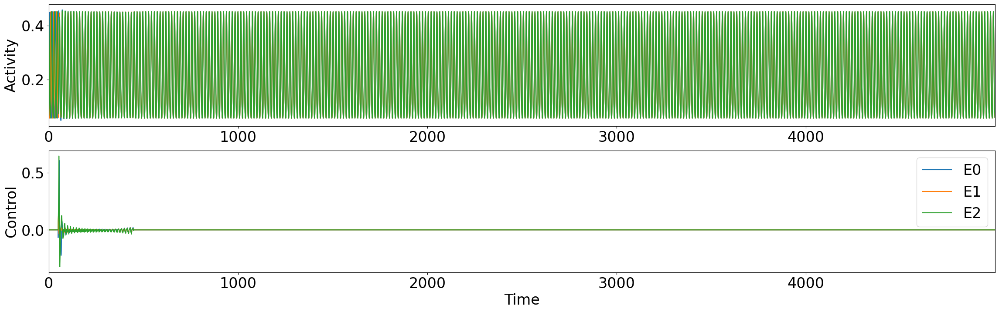

---------------------------------------  VAR


In [45]:
it = 10

dmat = delay_array[0] * cmats[0] * 20. 
model = WCModel(Cmat=cmats[i], Dmat=dmat)
model.params.K_gl = coupling_array[0]
dt = 0.1
model.params.dt = dt

model.params['duration'] = duration
model.params.exc_ext_baseline = eext[0]
model.params.inh_ext_baseline = iext[0]

model.params["exc_ext"] = zero_control[:,0,:]
model.params["inh_ext"] = zero_control[:,1,:]

for init_ind in range(2):

    if init_ind not in [0]: continue

    model.params["exc_init"] = data["init"][init_ind][0]
    model.params["inh_init"] = data["init"][init_ind][1]

    model.run()

    for mi, method in enumerate(["F", "CC", "VAR"]):

        print("--------------------------------------- ", method)

        if mi not in [1]: continue

        data["weights"][mi, init_ind] = 1

        #for factor in np.random.random(1):
        for factor in [1]:

            model_controlled = oc_wc.OcWc(model, target_period, print_array=pr, cost_interval=cost_interval, control_interval=control_interval,
                                        cost_matrix=costmat, control_matrix=controlmat)
            
            model_controlled.weights["w_p"] = 0.
            model_controlled.weights["w_2"] = data["weights"][mi, init_ind] * factor
            if method == "F":
                model_controlled.weights["w_f_sync"] = 1.
            elif method == "CC":
                model_controlled.weights["w_cc"] = 1.
            elif method == "VAR":
                model_controlled.weights["w_var"] = 1.

            model_controlled.maximum_control_strength = maxstr

            if True:
                if type(data["control"][mi][init_ind]) != type(None):
                    model_controlled.control = data["control"][mi][init_ind].copy()
                    model_controlled.update_input()

            for j in range(1):
                model_controlled.grad_method = 0
                model_controlled.channelwise_optimization = True

                for l in range(1):
                    for k in np.arange(-9., 9., 2.):
                        model_controlled.zero_step_encountered = False
                        model_controlled.step = 10**(k)
                        model_controlled.optimize(it)

                model_controlled.grad_method = 1
                model_controlled.channelwise_optimization = True

                for l in range(0):
                    for k in np.arange(-9., 9., 2.):
                        model_controlled.zero_step_encountered = False
                        model_controlled.step = 10**(k)
                        model_controlled.optimize(10)

            data["control"][mi][init_ind] = model_controlled.control.copy()
            data["state"][mi][init_ind] = model_controlled.get_xs()

        if True:
            mod = copy.deepcopy(model_controlled.model)
            mod.params.duration = 5000.
            input = np.zeros((N,2,1+int(mod.params.duration/dt)))
            input[:,:,:1+int(duration/dt)] = model_controlled.control.copy()
            mod.params.exc_ext = input[:,0,:]
            mod.run()

            plot_c = input.copy()
            plot_s = np.concatenate( (mod.exc[:,np.newaxis,:], mod.inh[:,np.newaxis,:]), axis=1 )

        coc = cost_functions.control_strength_cost(data["control"][mi][init_ind], weights, dt)
        data["control_cost"][mi, init_ind] = coc
        data["sync_cost"][mi, init_ind] = model_controlled.cost_history[-1] - data["weights"][mi, init_ind] * coc

        print("cost of control = ", coc)
        plot_control(data["control"][mi][init_ind], data["state"][mi][init_ind], duration, dt)
        plot_control(plot_c[:,:,1:], plot_s, mod.params.duration-dt, dt)

        with open(os.path.join(pickledir, 'beat_osc_3n.pickle'), 'wb') as f:
            pickle.dump(data, f)

In [44]:
def plot_control(c, s, dur, dt):
    if dur < 1000:
        y1lim = [1.1 * np.amin(c[:,:,1:]), 1.1 * np.amax(c[:,:,1:])]
        fig, ax = plt.subplots(2,1, figsize=(20,8), sharex=True)
    else:
        y1lim = [1.1 * np.amin(c), 1.1 * np.amax(c)]
        fig, ax = plt.subplots(2,1, figsize=(28,8))

    time_array = np.arange(0, dur+dt, dt)

    for n in range(N):
        ax[0].plot(time_array,s[n,0,:], label="E{}".format(n))
        ax[1].plot(time_array, c[n,0,:], label="E{}".format(n))

    #ax[0].legend(loc="lower right")
    ax[1].legend(loc="upper right")

    ax[0].set_xlim(0, dur)
    ax[1].set_xlim(0, dur)
    #ax[0].set_ylim(y0lim)
    #ax[1].set_ylim(y1lim)

    ax[1].set_xlabel("Time")
    ax[0].set_ylabel("Activity")
    ax[1].set_ylabel("Control")
    
    fig.align_ylabels([ax[:]])


    plt.show()
    return